## Final Project

#### In this file I explore the data and prepare it to work on the applicable machine learning models.

1. I download the libraries that I will use

In [1]:
import sys
!{sys.executable} -m pip install -U ydata-profiling[notebook]
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


In [2]:
import pandas as pd
import seaborn as sns
import numpy as np
import scipy.stats as st
from IPython.display import display
from pathlib import Path
from ipywidgets import widgets
from ydata_profiling import ProfileReport

2. Data exploration

In [3]:
data = pd.read_csv('../Data/raw/LifeExpectancyData.csv')
display(data)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [4]:
data.columns.values

array(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure',
       'Hepatitis B', 'Measles ', ' BMI ', 'under-five deaths ', 'Polio',
       'Total expenditure', 'Diphtheria ', ' HIV/AIDS', 'GDP',
       'Population', ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'], dtype=object)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   float64
 5   infant deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   percentage expenditure           2938 non-null   float64
 8   Hepatitis B                      2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10   BMI                             2904 non-null   float64
 11  under-five deaths                2938 non-null   int64  
 12  Polio               

3. After a first exploration, it is observed that it is necessary to homogenize the titles of the columns. To do this, a function is used.

In [6]:
def data_clean(df):
    df.columns = df.columns.str.lower()
    df.columns = [i.replace(' ', '_') for i in df.columns]
    df.columns = [i.replace('/', '_') for i in df.columns]
    df.columns = [i.replace('-', '_') for i in df.columns]
    df.columns = [column.strip('_') for column in df.columns]
    return df
data = data_clean(data)
display(data)

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


4. Null data are analyzed, and given the presence of a significant number of NaN in Hepatitis B, GDP and Population variables, mainly, each variable is analyzed in greater detail using a profile report in order to define the best way to treat NaNs.

In [7]:
nulls_df = pd.DataFrame(round(data.isna().sum()/len(data),4)*100)
nulls_df = nulls_df.reset_index()
nulls_df.columns = ['header_name', 'percent_nulls']
display(nulls_df)

,header_name,percent_nulls
0,country,0.00
1,year,0.00
2,status,0.00
3,life_expectancy,0.34
4,adult_mortality,0.34
5,infant_deaths,0.00
6,alcohol,6.60
7,percentage_expenditure,0.00
8,hepatitis_b,18.82
9,measles,0.00


In [8]:
profile = ProfileReport(data, title="Pandas Profiling Report", html={'style':{'full_width':True}})

In [9]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
profile.to_file("../Sliders/life_expentancy_explor.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

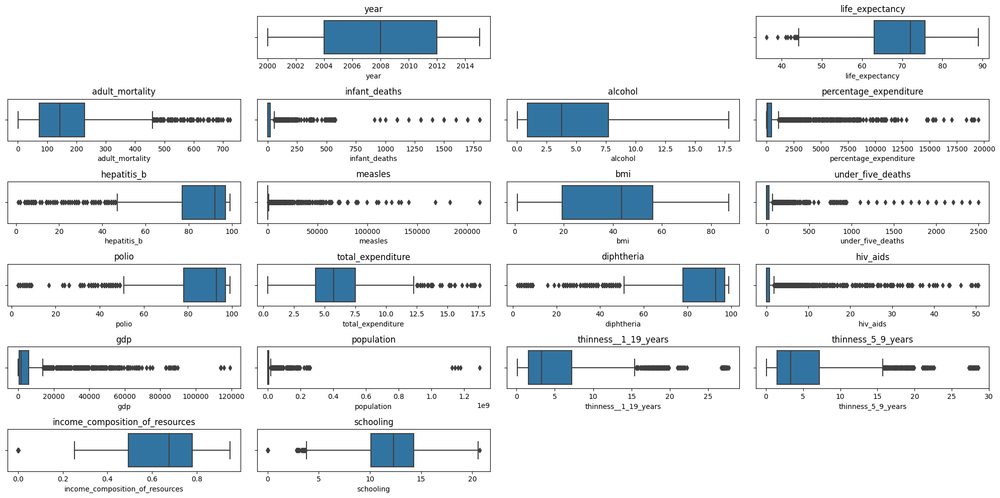

In [11]:
import matplotlib.pyplot as plt
%matplotlib inline

def create_boxplot(data):
    plt.figure(figsize=(20, 10))  
    cols = data.select_dtypes(exclude=['object']).columns.tolist()
    for col in cols:
        plt.subplot(6, 4, data.columns.get_loc(col) + 1)  # Add +1 to the index
        sns.boxplot(x=col, data=data)
        plt.title(col)
    plt.tight_layout()
    plt.show()
create_boxplot(data)

After analyzing the data I conclude that it is importantit to carry out the following:

1. Process the NaN data.
2. Define if the outliers should be removed.
3. Transform variable 'country' to eliminate high cardinality
4. Define if variable 'year' is relevant or not for the analysis. For which we will carry out an ANOVA test.

From this, three databases will be generated with which the regression models will be made, with the following characteristics:

data1
1. NaNs are removed.
2. Outliers are removed.
3. ANOVA test to define if 'year' is used or not.

data2
1. Countries are transformed into an ordinal categorical variable.
2. NaNs are treated with KNN.
3. Outliers are removed.


data3
1. Countries are transformed into an ordinal categorical variable.
2. NaNs are removed.
3. Outliers are NOT removed.

### Process to generate data1

1. NaNs are removed.

In [12]:
data.dropna(axis=0, inplace=True) 
data

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


2. Outliers are removed.

In [13]:
def remove_outliers(data, thr=1.5):
    cols = data.select_dtypes(exclude=['object']).columns.tolist()
    for col in cols:
        mean = data[col].mean()
        std = data[col].std()
        lower_bound = mean - (std * thr)
        upper_bound = mean + (std * thr)
        data1 = data[(data[col] >= lower_bound) & (data[col] <= upper_bound)] 
    return data1

data1 = remove_outliers(data)
data1

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [14]:
nulls_df = pd.DataFrame(round(data1.isna().sum()/len(data1),4)*100)
nulls_df = nulls_df.reset_index()
nulls_df.columns = ['header_name', 'percent_nulls']
display(nulls_df)

,header_name,percent_nulls
0,country,0.0
1,year,0.0
2,status,0.0
3,life_expectancy,0.0
4,adult_mortality,0.0
5,infant_deaths,0.0
6,alcohol,0.0
7,percentage_expenditure,0.0
8,hepatitis_b,0.0
9,measles,0.0


3. ANOVA test to define if 'year' is used or not.

In [15]:
life_expectancy_by_year = data1.groupby(['year']).agg({"life_expectancy":np.nanmean})
display(life_expectancy_by_year)

,life_expectancy
year,
2000,70.769643
2001,70.971186
2002,69.533803
2003,69.382716
2004,69.157778
2005,69.064286
2006,69.419417
2007,69.435238
2008,69.383486


In [16]:
st.f_oneway(data1[data1['year']==2000]['life_expectancy'],
           data1[data1['year']==2001]['life_expectancy'],
           data1[data1['year']==2002]['life_expectancy'],
           data1[data1['year']==2003]['life_expectancy'],
           data1[data1['year']==2004]['life_expectancy'],
           data1[data1['year']==2005]['life_expectancy'],
           data1[data1['year']==2006]['life_expectancy'],
           data1[data1['year']==2007]['life_expectancy'],
           data1[data1['year']==2008]['life_expectancy'],
           data1[data1['year']==2009]['life_expectancy'],
           data1[data1['year']==2010]['life_expectancy'],
           data1[data1['year']==2011]['life_expectancy'],
           data1[data1['year']==2012]['life_expectancy'],
           data1[data1['year']==2013]['life_expectancy'],
           data1[data1['year']==2014]['life_expectancy'],
           data1[data1['year']==2015]['life_expectancy'])

F_onewayResult(statistic=0.33378528242636996, pvalue=0.9919493220628887)

H0 for ANOVA is that the means of 'life_expectancy' for all the years are the same.

H1 is that they are not the same.

With the result of the ANOVA test we can see that pvalue> 0.05, so we accept H0. Since the means are the same, the year variable would not be relevant, so we can not include it in the machine learning models that we will test.

4. Eliminate 'year' and save this database as data1

In [17]:
data1 = data1.drop(columns=['year'])
data1

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [18]:
data1.to_csv('../Data/cleaned/data1.csv', index=False)

### Process to generate data2

We import the original database again to give it a new treatment. Since we saw in the database data1 that the variable year is not relevant, we will eliminate it from the beginning, for which we add this step in the function.

In [19]:
data = pd.read_csv('../Data/raw/LifeExpectancyData.csv')
display(data)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [20]:
def data_clean(df):
    df.columns = df.columns.str.lower()
    df.columns = [i.replace(' ', '_') for i in df.columns]
    df.columns = [i.replace('/', '_') for i in df.columns]
    df.columns = [i.replace('-', '_') for i in df.columns]
    df.columns = [column.strip('_') for column in df.columns]
    df = df.drop('year', axis=1)
    return df
data = data_clean(data)
display(data)

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [21]:
data['country'].unique()

array(['Afghanistan', 'Albania', 'Algeria', 'Angola',
       'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia',
       'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh',
       'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan',
       'Bolivia (Plurinational State of)', 'Bosnia and Herzegovina',
       'Botswana', 'Brazil', 'Brunei Darussalam', 'Bulgaria',
       'Burkina Faso', 'Burundi', "Côte d'Ivoire", 'Cabo Verde',
       'Cambodia', 'Cameroon', 'Canada', 'Central African Republic',
       'Chad', 'Chile', 'China', 'Colombia', 'Comoros', 'Congo',
       'Cook Islands', 'Costa Rica', 'Croatia', 'Cuba', 'Cyprus',
       'Czechia', "Democratic People's Republic of Korea",
       'Democratic Republic of the Congo', 'Denmark', 'Djibouti',
       'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
       'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia',
       'Georgia', 'Germany'

1. Countries are transformed into an ordinal categorical variable, and we add a new column named 'country_rank' with this value.

I apply an ANOVA test to validate if means of 'life_expectancy' for every country are equal or different. This is relevant to determine the type of transformation that can be made to the country variable.

As can be seen, the p-value was less than 0.05, so the null hypothesis is rejected and therefore the average 'life_expentancy' between the countries is not the same, so the country variable must be considered in the model.

To define the value for each country, the variable'life_expectancy' is grouped by country and every average is divided between the lowest average that corresponds to Sierra Leone. Null values ​​are assigned a value of 0.

In [22]:
life_expectancy_by_country = data.groupby(['country']).agg({"life_expectancy": np.nanmean})
life_expectancy_by_country = life_expectancy_by_country.sort_values(by='life_expectancy', ascending=False)
display(life_expectancy_by_country)

,life_expectancy
country,
Japan,82.53750
Sweden,82.51875
Iceland,82.44375
Switzerland,82.33125
France,82.21875
...,...
Niue,NaN
Palau,NaN
Saint Kitts and Nevis,NaN


In [23]:
st.f_oneway(data[data['country']=='Japan']['life_expectancy'],
           data[data['country']=='Sweden']['life_expectancy'],
           data[data['country']=='Iceland']['life_expectancy'],
           data[data['country']=='Switzerland']['life_expectancy'],
           data[data['country']=='France']['life_expectancy'],
           data[data['country']=='Italy']['life_expectancy'],
           data[data['country']=='Spain']['life_expectancy'],
           data[data['country']=='Australia']['life_expectancy'],
           data[data['country']=='Iceland']['life_expectancy'],
           data[data['country']=='Norway']['life_expectancy'],
           data[data['country']=='Canada']['life_expectancy'],
           data[data['country']=='Austria']['life_expectancy'],
           data[data['country']=='Singapore']['life_expectancy'],
           data[data['country']=='New Zealand']['life_expectancy'],
           data[data['country']=='Israel']['life_expectancy'],
           data[data['country']=='Greece']['life_expectancy'],
           data[data['country']=='Germany']['life_expectancy'],
           data[data['country']=='Netherlands']['life_expectancy'],
           data[data['country']=='United Kingdom of Great Britain and Northern Ireland']['life_expectancy'],
           data[data['country']=='Luxembourg']['life_expectancy'],
           data[data['country']=='Finland']['life_expectancy'],          
           data[data['country']=='Belgium']['life_expectancy'],
           data[data['country']=='Republic of Korea']['life_expectancy'],
           data[data['country']=='Malta']['life_expectancy'],
           data[data['country']=='Ireland']['life_expectancy'],
           data[data['country']=='Portugal']['life_expectancy'],
           data[data['country']=='Slovenia']['life_expectancy'],
           data[data['country']=='Cyprus']['life_expectancy'],
           data[data['country']=='Chile']['life_expectancy'],
           data[data['country']=='Denmark']['life_expectancy'],
           data[data['country']=='Costa Rica']['life_expectancy'],
           data[data['country']=='United States of America']['life_expectancy'],
           data[data['country']=='Cuba']['life_expectancy'],
           data[data['country']=='Qatar']['life_expectancy'],
           data[data['country']=='Czechia']['life_expectancy'],
           data[data['country']=='Panama']['life_expectancy'],
           data[data['country']=='Brunei Darussalam']['life_expectancy'],
           data[data['country']=='Croatia']['life_expectancy'],
           data[data['country']=='Uruguay']['life_expectancy'],
           data[data['country']=='Bosnia and Herzegovina']['life_expectancy'],
           data[data['country']=='Bahrain']['life_expectancy'],
           data[data['country']=='Mexico']['life_expectancy'],
           data[data['country']=='United Arab Emirates']['life_expectancy'],
           data[data['country']=='Poland']['life_expectancy'],
           data[data['country']=='Maldives']['life_expectancy'],
           data[data['country']=='Albania']['life_expectancy'],
           data[data['country']=='Argentina']['life_expectancy'],
           data[data['country']=='Antigua and Barbuda']['life_expectancy'],
           data[data['country']=='Estonia']['life_expectancy'],
           data[data['country']=='Oman']['life_expectancy'],          
           data[data['country']=='Viet Nam']['life_expectancy'],
           data[data['country']=='Slovakia']['life_expectancy'],
           data[data['country']=='Ecuador']['life_expectancy'],
           data[data['country']=='Montenegro']['life_expectancy'],
           data[data['country']=='Barbados']['life_expectancy'],
           data[data['country']=='Tunisia']['life_expectancy'],
           data[data['country']=='Jamaica']['life_expectancy'],
           data[data['country']=='Bahamas']['life_expectancy'],
           data[data['country']=='China']['life_expectancy'],
           data[data['country']=='Lebanon']['life_expectancy'],
           data[data['country']=='The former Yugoslav republic of Macedonia']['life_expectancy'],
           data[data['country']=='Romania']['life_expectancy'],
           data[data['country']=='Serbia']['life_expectancy'],
           data[data['country']=='Turkey']['life_expectancy'],
           data[data['country']=='Iran (Islamic Republic of)']['life_expectancy'],
           data[data['country']=='Kuwait']['life_expectancy'],
           data[data['country']=='Hungary']['life_expectancy'],
           data[data['country']=='Malaysia']['life_expectancy'],
           data[data['country']=='Latvia']['life_expectancy'],
           data[data['country']=='Peru']['life_expectancy'],
           data[data['country']=='Samoa']['life_expectancy'],  
           data[data['country']=='Algeria']['life_expectancy'],
           data[data['country']=='Saint Lucia']['life_expectancy'],
           data[data['country']=='Georgia']['life_expectancy'],
           data[data['country']=='Saint Vincent and the Grenadines']['life_expectancy'],
           data[data['country']=='Saudi Arabia']['life_expectancy'],
           data[data['country']=='Nicaragua']['life_expectancy'],
           data[data['country']=='Sri Lanka']['life_expectancy'],
           data[data['country']=='Armenia']['life_expectancy'],
           data[data['country']=='Venezuela (Bolivarian Republic of)']['life_expectancy'],   
           data[data['country']=='Brazil']['life_expectancy'],
           data[data['country']=='Grenada']['life_expectancy'],
           data[data['country']=='Colombia']['life_expectancy'],
           data[data['country']=='Paraguay']['life_expectancy'],
           data[data['country']=='Thailand']['life_expectancy'],
           data[data['country']=='Honduras']['life_expectancy'],
           data[data['country']=='Jordan']['life_expectancy'],
           data[data['country']=='Bulgaria']['life_expectancy'],
           data[data['country']=='Lithuania']['life_expectancy'],
           data[data['country']=='Mauritius']['life_expectancy'],
           data[data['country']=='Tonga']['life_expectancy'],
           data[data['country']=='Cabo Verde']['life_expectancy'],
           data[data['country']=='Libya']['life_expectancy'],
           data[data['country']=='Seychelles']['life_expectancy'],
           data[data['country']=='Dominican Republic']['life_expectancy'],
           data[data['country']=='Morocco']['life_expectancy'],
           data[data['country']=='El Salvador']['life_expectancy'],
           data[data['country']=='Guatemala']['life_expectancy'],
           data[data['country']=='Egypt']['life_expectancy'],
           data[data['country']=='Vanuatu']['life_expectancy'],
           data[data['country']=='Trinidad and Tobago']['life_expectancy'],   
           data[data['country']=='Syrian Arab Republic']['life_expectancy'],
           data[data['country']=='Azerbaijan']['life_expectancy'],
           data[data['country']=='Iraq']['life_expectancy'],
           data[data['country']=='Suriname']['life_expectancy'],
           data[data['country']=='Republic of Moldova']['life_expectancy'],
           data[data['country']=='Ukraine']['life_expectancy'],
           data[data['country']=='Belarus']['life_expectancy'],   
           data[data['country']=='Bangladesh']['life_expectancy'],
           data[data['country']=='Belize']['life_expectancy'],
           data[data['country']=="Democratic People's Republic of Korea"]['life_expectancy'],
           data[data['country']=='Kyrgyzstan']['life_expectancy'],
           data[data['country']=='Fiji']['life_expectancy'],
           data[data['country']=='Micronesia (Federated States of)']['life_expectancy'],
           data[data['country']=='Uzbekistan']['life_expectancy'],
           data[data['country']=='Russian Federation']['life_expectancy'],
           data[data['country']=='Solomon Islands']['life_expectancy'],
           data[data['country']=='Bolivia (Plurinational State of)']['life_expectancy'],
           data[data['country']=='Philippines']['life_expectancy'],
           data[data['country']=='Indonesia']['life_expectancy'],
           data[data['country']=='Kazakhstan']['life_expectancy'],
           data[data['country']=='Tajikistan']['life_expectancy'],
           data[data['country']=='Nepal']['life_expectancy'],
           data[data['country']=='Bhutan']['life_expectancy'],
           data[data['country']=='Mongolia']['life_expectancy'],
           data[data['country']=='Guyana']['life_expectancy'],
           data[data['country']=='India']['life_expectancy'],
           data[data['country']=='Sao Tome and Principe']['life_expectancy'],
           data[data['country']=='Kiribati']['life_expectancy'],   
           data[data['country']=='Timor-Leste']['life_expectancy'],
           data[data['country']=='Turkmenistan']['life_expectancy'],
           data[data['country']=='Pakistan']['life_expectancy'],
           data[data['country']=='Cambodia']['life_expectancy'],
           data[data['country']=='Myanmar']['life_expectancy'],
           data[data['country']=='Yemen']['life_expectancy'],
           data[data['country']=='Mauritania']['life_expectancy'],   
           data[data['country']=='Madagascar']['life_expectancy'],
           data[data['country']=='Senegal']['life_expectancy'],
           data[data['country']=="Lao People's Democratic Republic"]['life_expectancy'],
           data[data['country']=='Gabon']['life_expectancy'],
           data[data['country']=='Sudan']['life_expectancy'],
           data[data['country']=='Papua New Guinea']['life_expectancy'],
           data[data['country']=='Comoros']['life_expectancy'],
           data[data['country']=='Ghana']['life_expectancy'],
           data[data['country']=='Djibouti']['life_expectancy'],
           data[data['country']=='Eritrea']['life_expectancy'],
           data[data['country']=='Namibia']['life_expectancy'],
           data[data['country']=='Haiti']['life_expectancy'],
           data[data['country']=='Gambia']['life_expectancy'],
           data[data['country']=='Rwanda']['life_expectancy'],
           data[data['country']=='Ethiopia']['life_expectancy'],
           data[data['country']=='Congo']['life_expectancy'],
           data[data['country']=='Afghanistan']['life_expectancy'],
           data[data['country']=='Benin']['life_expectancy'],
           data[data['country']=='Liberia']['life_expectancy'],
           data[data['country']=='South Africa']['life_expectancy'],
           data[data['country']=='Kenya']['life_expectancy'],   
           data[data['country']=='Niger']['life_expectancy'],
           data[data['country']=='Togo']['life_expectancy'],
           data[data['country']=='Botswana']['life_expectancy'],   
           data[data['country']=='United Republic of Tanzania']['life_expectancy'],   
           data[data['country']=='Uganda']['life_expectancy'],
           data[data['country']=='Democratic Republic of the Congo']['life_expectancy'],
           data[data['country']=='Burkina Faso']['life_expectancy'],
           data[data['country']=='Burundi']['life_expectancy'],
           data[data['country']=='Guinea-Bissau']['life_expectancy'],
           data[data['country']=='Equatorial Guinea']['life_expectancy'],
           data[data['country']=='Mali']['life_expectancy'],
           data[data['country']=='Cameroon']['life_expectancy'],
           data[data['country']=='Zambia']['life_expectancy'],
           data[data['country']=='South Sudan']['life_expectancy'],
           data[data['country']=='Mozambique']['life_expectancy'],
           data[data['country']=='Somalia']['life_expectancy'],
           data[data['country']=='Nigeria']['life_expectancy'],   
           data[data['country']=='Swaziland']['life_expectancy'],
           data[data['country']=='Zimbabwe']['life_expectancy'],
           data[data['country']=="Côte d'Ivoire"]['life_expectancy'],
           data[data['country']=='Chad']['life_expectancy'],  
           data[data['country']=='Malawi']['life_expectancy'],   
           data[data['country']=='Angola']['life_expectancy'],
           data[data['country']=='Lesotho']['life_expectancy'],
           data[data['country']=='Central African Republic']['life_expectancy'],
           data[data['country']=='Sierra Leone']['life_expectancy'],  
           )

F_onewayResult(statistic=187.75305697736636, pvalue=0.0)

In [24]:
result_list = list(zip(life_expectancy_by_country.index, life_expectancy_by_country['life_expectancy']))
result_list
result_df = pd.DataFrame(result_list, columns=['country', 'life_expectancy'])
result_df['life_expectancy'].fillna(0, inplace=True)

In [25]:
mapping_dict = {}
sierra_leone_life_expectancy = None

# Find the life expectancy of Sierra Leone
for country, life_expectancy in result_list:
    if country == 'Sierra Leone':
        sierra_leone_life_expectancy = life_expectancy
        break

# Calculate the relative life expectancy for each country
for country, life_expectancy in result_list:
    relative_life_expectancy = life_expectancy / sierra_leone_life_expectancy
    mapping_dict[country] = relative_life_expectancy
data['country_rank'] = data['country'].map(mapping_dict)
data

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling,country_rank
0,Afghanistan,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1.261995
1,Afghanistan,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1.261995
2,Afghanistan,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1.261995
3,Afghanistan,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1.261995
4,Afghanistan,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1.261995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2,1.094877
2934,Zimbabwe,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5,1.094877
2935,Zimbabwe,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0,1.094877
2936,Zimbabwe,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8,1.094877


2. NaNs are treated with KNN.

I divide the variables into categorical and numerical, to work with the numerical variables the treatment of NaN and the elimination of outliers.

In [26]:
categorical_columns = data.select_dtypes(include=['object']).columns
data_categorical = data[categorical_columns]

In [27]:
numerical_columns = data.select_dtypes(include=['float', 'int']).columns
data_numerical = data[numerical_columns]

from sklearn.impute import KNNImputer
data_knn = KNNImputer()
data_imputed_knn = data_knn.fit_transform(data_numerical)
data_knn = pd.DataFrame(data_imputed_knn, columns=data_numerical.columns)
data_knn

,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,under_five_deaths,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling,country_rank
0,65.0,263.0,62.0,0.01,71.279624,65.0,1154.0,19.1,83.0,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1.261995
1,59.9,271.0,64.0,0.01,73.523582,62.0,492.0,18.6,86.0,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1.261995
2,59.9,268.0,66.0,0.01,73.219243,64.0,430.0,18.1,89.0,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1.261995
3,59.5,272.0,69.0,0.01,78.184215,67.0,2787.0,17.6,93.0,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1.261995
4,59.2,275.0,71.0,0.01,7.097109,68.0,3013.0,17.2,97.0,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1.261995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,44.3,723.0,27.0,4.36,0.000000,68.0,31.0,27.1,42.0,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2,1.094877
2934,44.5,715.0,26.0,4.06,0.000000,7.0,998.0,26.7,41.0,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5,1.094877
2935,44.8,73.0,25.0,4.43,0.000000,73.0,304.0,26.3,40.0,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0,1.094877
2936,45.3,686.0,25.0,1.72,0.000000,76.0,529.0,25.9,39.0,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8,1.094877


We can visualice the impact of apply KNNImpute to NaN.

In [28]:
from scipy.stats import skew, kurtosis
color_pal = sns.color_palette(palette='muted')
null_features = ['life_expectancy', 'adult_mortality',
       'alcohol', 'hepatitis_b', 'bmi', 'polio',
       'total_expenditure', 'diphtheria', 'gdp', 'population',
       'thinness__1_19_years', 'thinness_5_9_years',
       'income_composition_of_resources', 'schooling']
def draw_histplot():
    f, axes = plt.subplots(nrows=len(null_features), ncols=2, figsize=(24, len(null_features)*6))
    for x in range(0, len(null_features)):
        sns.histplot(data, x=null_features[x], kde=True, ax=axes[x, 0], color=color_pal[0])
        sns.histplot(data_knn, x=null_features[x], kde=True, ax=axes[x, 1], color=color_pal[1])
    for i, ax in enumerate(axes.reshape(-1)):
        if i % 2 == 0:
            selected_title = 'Before Imputation'
            selected_data = data[null_features[int(i/2)]].dropna()
        elif i % 2 == 1:
            selected_title = 'KNN Imputation'
            selected_data = data_knn[null_features[int(i/2)]]
        ax.set_title(selected_title)
        ax.text(x=0.97, y=0.97, transform=ax.transAxes, s="Skewness: %f" % skew(selected_data),\
            fontsize=9, verticalalignment='top', horizontalalignment='right')
        ax.text(x=0.97, y=0.91, transform=ax.transAxes, s="Kurtosis: %f" % kurtosis(selected_data),\
            fontsize=9, verticalalignment='top', horizontalalignment='right')

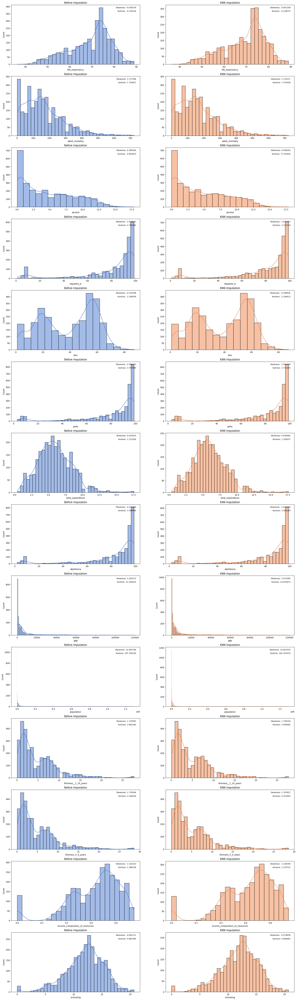

In [29]:
draw_histplot()

3. Outliers are removed.

In [30]:
def remove_outliers(data_knn, thr=1.5):
    for col in data_knn:
        mean = data_knn[col].mean()
        std = data_knn[col].std()
        lower_bound = mean - (std * thr)
        upper_bound = mean + (std * thr)
        data2 = data_knn[(data_knn[col] >= lower_bound) & (data_knn[col] <= upper_bound)] 
    return data2

data_clean = remove_outliers(data_knn)
data_clean

,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,under_five_deaths,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling,country_rank
0,65.0,263.0,62.0,0.01,71.279624,65.0,1154.0,19.1,83.0,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1.261995
1,59.9,271.0,64.0,0.01,73.523582,62.0,492.0,18.6,86.0,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1.261995
2,59.9,268.0,66.0,0.01,73.219243,64.0,430.0,18.1,89.0,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1.261995
3,59.5,272.0,69.0,0.01,78.184215,67.0,2787.0,17.6,93.0,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1.261995
4,59.2,275.0,71.0,0.01,7.097109,68.0,3013.0,17.2,97.0,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1.261995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2901,62.2,247.0,42.0,0.06,0.000000,43.0,12708.0,33.3,56.0,72.0,4.90,72.0,0.1,895.016624,76920800.6,13.9,13.9,0.464,8.4,1.384928
2902,61.9,249.0,43.0,0.04,0.000000,38.0,8536.0,32.7,58.0,61.0,5.00,61.0,0.1,769.381712,9337280.6,14.0,13.9,0.457,8.2,1.384928
2903,61.5,25.0,45.0,0.07,0.000000,31.0,890.0,32.2,61.0,64.0,4.22,65.0,0.1,808.264285,19281008.2,14.0,14.0,0.450,8.0,1.384928
2904,61.1,251.0,46.0,0.08,0.000000,19.0,485.0,31.7,63.0,73.0,4.34,73.0,0.1,860.356336,14617579.6,14.0,14.0,0.444,7.9,1.384928


4. I concatenate the categorical and numeric variables to generate data2.

In [31]:
data_knn

,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,under_five_deaths,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling,country_rank
0,65.0,263.0,62.0,0.01,71.279624,65.0,1154.0,19.1,83.0,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1.261995
1,59.9,271.0,64.0,0.01,73.523582,62.0,492.0,18.6,86.0,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1.261995
2,59.9,268.0,66.0,0.01,73.219243,64.0,430.0,18.1,89.0,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1.261995
3,59.5,272.0,69.0,0.01,78.184215,67.0,2787.0,17.6,93.0,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1.261995
4,59.2,275.0,71.0,0.01,7.097109,68.0,3013.0,17.2,97.0,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1.261995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,44.3,723.0,27.0,4.36,0.000000,68.0,31.0,27.1,42.0,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2,1.094877
2934,44.5,715.0,26.0,4.06,0.000000,7.0,998.0,26.7,41.0,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5,1.094877
2935,44.8,73.0,25.0,4.43,0.000000,73.0,304.0,26.3,40.0,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0,1.094877
2936,45.3,686.0,25.0,1.72,0.000000,76.0,529.0,25.9,39.0,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8,1.094877


In [32]:
data2 = data_clean.join(data_categorical, how='inner')
data2

,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,under_five_deaths,polio,...,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling,country_rank,country,status
0,65.0,263.0,62.0,0.01,71.279624,65.0,1154.0,19.1,83.0,6.0,...,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1.261995,Afghanistan,Developing
1,59.9,271.0,64.0,0.01,73.523582,62.0,492.0,18.6,86.0,58.0,...,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1.261995,Afghanistan,Developing
2,59.9,268.0,66.0,0.01,73.219243,64.0,430.0,18.1,89.0,62.0,...,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1.261995,Afghanistan,Developing
3,59.5,272.0,69.0,0.01,78.184215,67.0,2787.0,17.6,93.0,67.0,...,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1.261995,Afghanistan,Developing
4,59.2,275.0,71.0,0.01,7.097109,68.0,3013.0,17.2,97.0,68.0,...,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1.261995,Afghanistan,Developing
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2901,62.2,247.0,42.0,0.06,0.000000,43.0,12708.0,33.3,56.0,72.0,...,0.1,895.016624,76920800.6,13.9,13.9,0.464,8.4,1.384928,Yemen,Developing
2902,61.9,249.0,43.0,0.04,0.000000,38.0,8536.0,32.7,58.0,61.0,...,0.1,769.381712,9337280.6,14.0,13.9,0.457,8.2,1.384928,Yemen,Developing
2903,61.5,25.0,45.0,0.07,0.000000,31.0,890.0,32.2,61.0,64.0,...,0.1,808.264285,19281008.2,14.0,14.0,0.450,8.0,1.384928,Yemen,Developing
2904,61.1,251.0,46.0,0.08,0.000000,19.0,485.0,31.7,63.0,73.0,...,0.1,860.356336,14617579.6,14.0,14.0,0.444,7.9,1.384928,Yemen,Developing


I check that there are not NaN data and save data2.

In [33]:
nulls_df = pd.DataFrame(round(data2.isna().sum()/len(data2),4)*100)
nulls_df = nulls_df.reset_index()
nulls_df.columns = ['header_name', 'percent_nulls']
display(nulls_df)

,header_name,percent_nulls
0,life_expectancy,0.0
1,adult_mortality,0.0
2,infant_deaths,0.0
3,alcohol,0.0
4,percentage_expenditure,0.0
5,hepatitis_b,0.0
6,measles,0.0
7,bmi,0.0
8,under_five_deaths,0.0
9,polio,0.0


In [34]:
data2.to_csv('../Data/cleaned/data2.csv', index=False)

### Process to generate Data3

We import the original database again to give it a new treatment. Similar to database 2, we will eliminate the variable year from the beginning, for which we add this step in the function.

In [35]:
data = pd.read_csv('../Data/raw/LifeExpectancyData.csv')
display(data)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [36]:
def data_clean(df):
    df.columns = df.columns.str.lower()
    df.columns = [i.replace(' ', '_') for i in df.columns]
    df.columns = [i.replace('/', '_') for i in df.columns]
    df.columns = [i.replace('-', '_') for i in df.columns]
    df.columns = [column.strip('_') for column in df.columns]
    df = df.drop('year', axis=1)
    return df
data = data_clean(data)
display(data)

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


1. Countries are transformed into an ordinal categorical variable.

Using the function mapping that we use in the previous database, we transform the variable 'country' into an ordinal categorical variable.

In [37]:
life_expectancy_by_country = data.groupby(['country']).agg({"life_expectancy": np.nanmean})
life_expectancy_by_country = life_expectancy_by_country.sort_values(by='life_expectancy', ascending=False)
display(life_expectancy_by_country)

,life_expectancy
country,
Japan,82.53750
Sweden,82.51875
Iceland,82.44375
Switzerland,82.33125
France,82.21875
...,...
Niue,NaN
Palau,NaN
Saint Kitts and Nevis,NaN


In [38]:
result_list = list(zip(life_expectancy_by_country.index, life_expectancy_by_country['life_expectancy']))
result_list
result_df = pd.DataFrame(result_list, columns=['country', 'life_expectancy'])
result_df['life_expectancy'].fillna(0, inplace=True)

In [39]:
mapping_dict = {}
sierra_leone_life_expectancy = None

# Find the life expectancy of Sierra Leone
for country, life_expectancy in result_list:
    if country == 'Sierra Leone':
        sierra_leone_life_expectancy = life_expectancy
        break

# Calculate the relative life expectancy for each country
for country, life_expectancy in result_list:
    relative_life_expectancy = life_expectancy / sierra_leone_life_expectancy
    mapping_dict[country] = relative_life_expectancy
data['country_rank'] = data['country'].map(mapping_dict)
data

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling,country_rank
0,Afghanistan,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1.261995
1,Afghanistan,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1.261995
2,Afghanistan,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1.261995
3,Afghanistan,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1.261995
4,Afghanistan,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1.261995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2,1.094877
2934,Zimbabwe,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5,1.094877
2935,Zimbabwe,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0,1.094877
2936,Zimbabwe,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8,1.094877


2. NaNs are removed.

In [40]:
data.dropna(axis=0, inplace=True) 
data

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling,country_rank
0,Afghanistan,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1.261995
1,Afghanistan,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1.261995
2,Afghanistan,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1.261995
3,Afghanistan,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1.261995
4,Afghanistan,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1.261995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2,1.094877
2934,Zimbabwe,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5,1.094877
2935,Zimbabwe,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0,1.094877
2936,Zimbabwe,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8,1.094877


In [41]:
nulls_df = pd.DataFrame(round(data.isna().sum()/len(data),4)*100)
nulls_df = nulls_df.reset_index()
nulls_df.columns = ['header_name', 'percent_nulls']
display(nulls_df)

,header_name,percent_nulls
0,country,0.0
1,status,0.0
2,life_expectancy,0.0
3,adult_mortality,0.0
4,infant_deaths,0.0
5,alcohol,0.0
6,percentage_expenditure,0.0
7,hepatitis_b,0.0
8,measles,0.0
9,bmi,0.0


3. Outliers are NOT removed.

In this case, we NOT removed outliers, so just save in a new file the data without NaN, and without the column 'years'.

In [42]:
data.to_csv('../Data/cleaned/data3.csv', index=False)

With the cleaned database data1, data2 and data3 I will run the machine learning models in a new jupyter notebook.